<a href="https://colab.research.google.com/github/FatimaJahara/ComplexityT2I/blob/main/test_complexity_2_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install diffusers==0.18.0
!pip install transformers scipy ftfy
!pip install "ipywidgets>=7,<8"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 14.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 50.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 100.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 82.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 11.3 MB/s eta 0:00:00


In [ ]:
import torch
from diffusers import StableDiffusionPipeline
from PIL import Image

# model21 = "stabilityai/stable-diffusion-2-1"
model15 = "runwayml/stable-diffusion-v1-5"

# pipe21 = StableDiffusionPipeline.from_pretrained(model21)
pipe15 = StableDiffusionPipeline.from_pretrained(model15)

# pipe21 = pipe21.to("cuda")
pipe15 = pipe15.to("cuda")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

Cannot initialize model with low cpu memory usage because `accelerate` was not found in the environment. Defaulting to `low_cpu_mem_usage=False`. It is strongly recommended to install `accelerate` for faster and less memory-intense model loading. You can do so with: 
```
pip install accelerate
```
.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["bos_token_id"]` will be overriden.
`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["eos_token_id"]` will be overriden.


In [ ]:
def image_grid(imgs, rows=2, cols=2):
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

def get_inputs(prompt, batch_size=1):
  generator = [torch.Generator("cuda").manual_seed(i) for i in range(batch_size)]
  prompts = batch_size * [prompt]
  num_inference_steps = 20

  return {"prompt": prompts, "generator": generator, "num_inference_steps": num_inference_steps}

In [ ]:
prompts = [  "A man drawing a picture of two girls under a tree",
           "A many drawing a picture of two girls under a tree.",
    "A more better man drawing a picture of two girls under a tree.",
    "A man drawing a picture of two girls under a tree there.",
    "And a man drawing a picture of two girls under a tree.",
    "A man's drawing a picture of two girls under a tree.",
    "A man drawing picture of two girls under a tree.",
    "A man drawing a picture of.",
    "A man draw a picture of two girls under a tree.",
    "A man drawing a picture of two grils under a tree.",
    "A man drawing a picture of two girlss under a tree.",
    "A man drawing a picture of twos girls under a tree.",
    "A man drawing a picture of two girl's under a tree.",
    "A man drawing a picture of two girls under atree.",
    "Many man drawing a picture of two girls under a tree.",
    "A man drawing a picture off two girls under a tree.",
    "A man drawing a picture two girls under a tree.",
    "He drawing a picture of two girls under a tree.",
    "A man drawing a picture of two girls under a tree.",
    "A man draing a picture of two girls under a tree.",
    "A man drew a picture of two girls under a tree.",
    "A man drawn a picture of two girls under a tree.",
    "A man draws a picture of two girls under a tree.",
    "A men drawing a picture of two girls under a tree.",
    "A man draws a picture of two girls under a tree.",
    "A man drawing a picture two girls of under a tree."
]

image_set = []
for prompt in prompts:
    images = pipe15(**get_inputs(prompt, batch_size=5)).images
    image_set.append(images)
    image_grid(images, rows=1, cols=5)

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

In [ ]:
import numpy as np
from PIL import Image

def calculate_l2_norm(image1, image2):
    # Convert PIL Images to numpy arrays
    array1 = np.array(image1)
    array2 = np.array(image2)
    l2_norm = np.sqrt(np.sum(np.power((array1-array2),2)))
    return l2_norm

In [ ]:
# Calculate the L2 norm for each pair of images

l2_norm = [[],[],[],[],[],[],[],[], [],[],[],[],[],[],[],[], [],[],[],[],[],[],[], [], []]
for i in range(5):
    l2_norm[0].append(calculate_l2_norm(image_set[0][i], image_set[1][i]))
    l2_norm[1].append(calculate_l2_norm(image_set[0][i], image_set[2][i]))
    l2_norm[2].append(calculate_l2_norm(image_set[0][i], image_set[3][i]))
    l2_norm[3].append(calculate_l2_norm(image_set[0][i], image_set[4][i]))
    l2_norm[4].append(calculate_l2_norm(image_set[0][i], image_set[5][i]))
    l2_norm[5].append(calculate_l2_norm(image_set[0][i], image_set[6][i]))
    l2_norm[6].append(calculate_l2_norm(image_set[0][i], image_set[7][i]))
    l2_norm[7].append(calculate_l2_norm(image_set[0][i], image_set[8][i]))
    l2_norm[8].append(calculate_l2_norm(image_set[0][i], image_set[9][i]))
    l2_norm[9].append(calculate_l2_norm(image_set[0][i], image_set[10][i]))
    l2_norm[10].append(calculate_l2_norm(image_set[0][i], image_set[11][i]))
    l2_norm[11].append(calculate_l2_norm(image_set[0][i], image_set[12][i]))
    l2_norm[12].append(calculate_l2_norm(image_set[0][i], image_set[13][i]))
    l2_norm[13].append(calculate_l2_norm(image_set[0][i], image_set[14][i]))
    l2_norm[14].append(calculate_l2_norm(image_set[0][i], image_set[15][i]))
    l2_norm[15].append(calculate_l2_norm(image_set[0][i], image_set[16][i]))
    l2_norm[16].append(calculate_l2_norm(image_set[0][i], image_set[17][i]))
    l2_norm[17].append(calculate_l2_norm(image_set[0][i], image_set[18][i]))
    l2_norm[18].append(calculate_l2_norm(image_set[0][i], image_set[19][i]))
    l2_norm[19].append(calculate_l2_norm(image_set[0][i], image_set[20][i]))
    l2_norm[20].append(calculate_l2_norm(image_set[0][i], image_set[21][i]))
    l2_norm[21].append(calculate_l2_norm(image_set[0][i], image_set[22][i]))
    l2_norm[22].append(calculate_l2_norm(image_set[0][i], image_set[23][i]))
    l2_norm[23].append(calculate_l2_norm(image_set[0][i], image_set[24][i]))
    l2_norm[24].append(calculate_l2_norm(image_set[0][i], image_set[25][i]))


flat_l2_norm = [norm for sublist in l2_norm for norm in sublist]
min_value = np.min(flat_l2_norm)
max_value = np.max(flat_l2_norm)

# Normalize the L2 norms
l2_norm_normalized = [[(val - min_value) / (max_value - min_value) for val in sublist] for sublist in l2_norm]

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

def l2_norm_group_bar(l2_norms_complexity):

    image_pairs = ["Pair 1", "Pair 2", "Pair 3", "Pair 4", "Pair 5"]  # And these with your actual image pair names
    complexities = ["1-2", "1-3", "1-4", "1-5", "1-6", "1-7", "1-8", "1-9", "1-10", "1-11", "1-12", "1-13", "1-14", "1-15", "1-16", "1-17", "1-18", "1-19", "1-20", "1-21", "1-22", "1-23", "1-24", "1-25", "1-26"]

# The number of complexities
    N = len(complexities)

# The x locations for the groups
    ind = np.arange(N)

# The width of the bars
    width = 0.1

# Create a figure and a set of subplots
    fig, ax = plt.subplots()

    for i in range(len(image_pairs)):
        ax.bar(ind + i*width, [l2[i] for l2 in l2_norms_complexity], width, label=image_pairs[i])

    # Add some text for labels, title and custom x-axis tick labels, etc.
    ax.set_xlabel('Complexity')
    # ax.set_ylabel('Normalized L2 Norm')
    # ax.set_title('Normalized L2 Norms by complexity and fixed-seed image pairs')
    ax.set_ylabel('L2 Norm')
    ax.set_title('L2 Norms by complexity and image pairs')
    ax.set_xticks(ind + width / 2)
    ax.set_xticklabels(complexities)
    # ax.legend()

    # Show the plot
    plt.show()

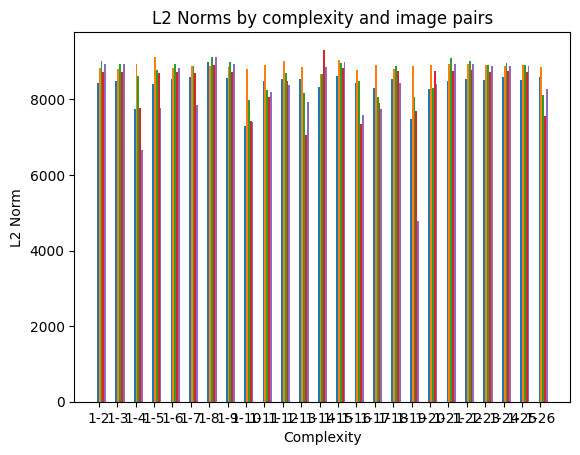

In [ ]:
l2_norm_group_bar(l2_norm)

In [ ]:
import matplotlib.pyplot as plt

# List of list of images
your_list_of_images = image_set

# Create figure with sub-plots.
fig, axes = plt.subplots(len(your_list_of_images), len(your_list_of_images[0]), figsize=(200, 200))

# Iterate over the sub-plots and show images.
for i, row in enumerate(axes):
    for j, ax in enumerate(row):
        ax.imshow(your_list_of_images[i][j])
        ax.axis('off')  # to remove the axis of image sub-plots

# Remove the spaces between subplots
plt.subplots_adjust(wspace=0, hspace=0)

plt.show()

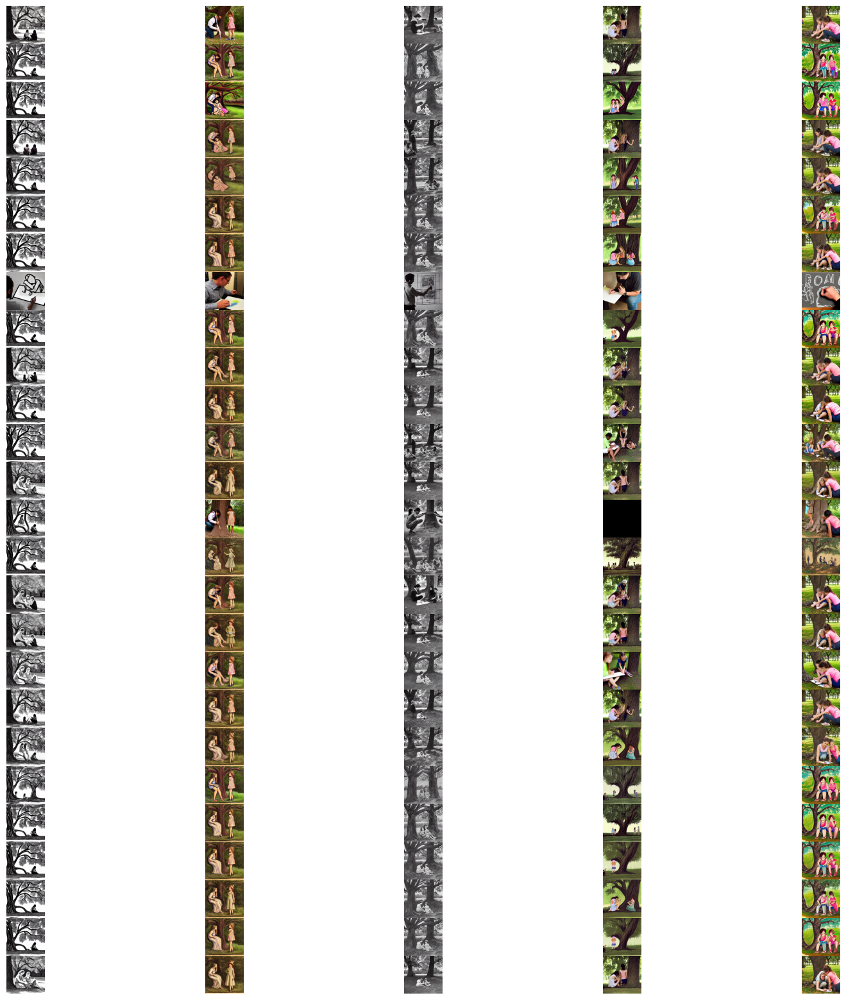

In [ ]:
import matplotlib.pyplot as plt

# List of list of images
your_list_of_images = image_set

# Create figure with sub-plots.
fig, axes = plt.subplots(len(your_list_of_images), len(your_list_of_images[0]), figsize=(20, 20))

# Iterate over the sub-plots and show images.
for i, row in enumerate(axes):
    for j, ax in enumerate(row):
        ax.imshow(your_list_of_images[i][j])
        ax.axis('off')  # to remove the axis of image sub-plots

# Remove the spaces between subplots
plt.subplots_adjust(wspace=0, hspace=0)

plt.show()

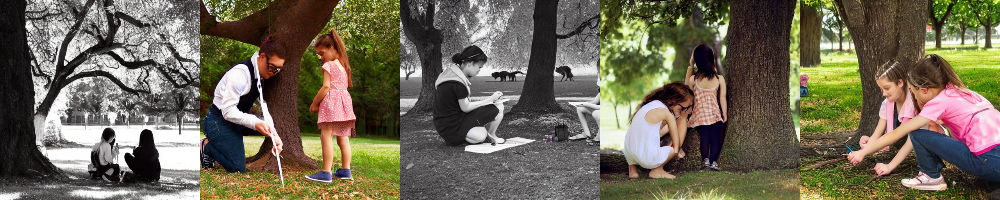

In [ ]:
image_grid(image_set[0], rows=1, cols=5)

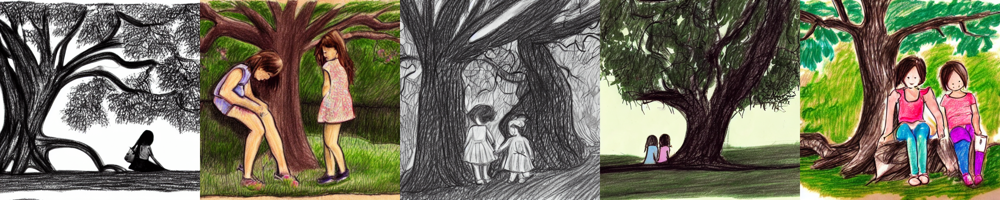

In [ ]:
image_grid(image_set[1], rows=1, cols=5)

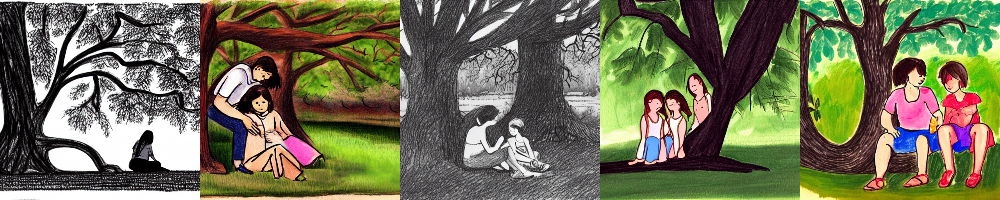

In [ ]:
image_grid(image_set[2], rows=1, cols=5)

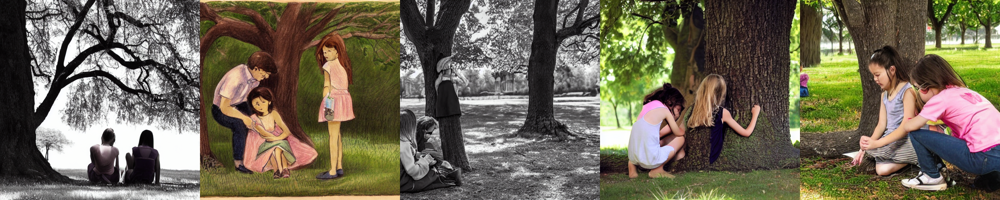

In [ ]:
image_grid(image_set[3], rows=1, cols=5)

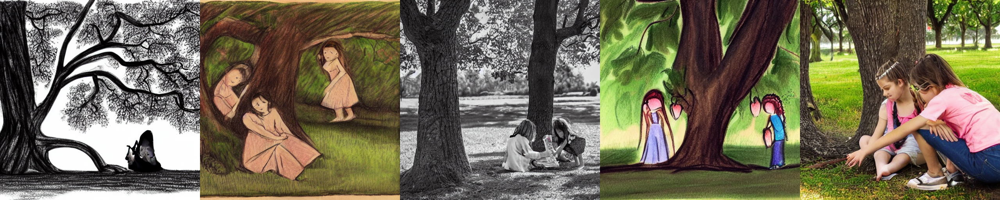

In [ ]:
image_grid(image_set[4], rows=1, cols=5)

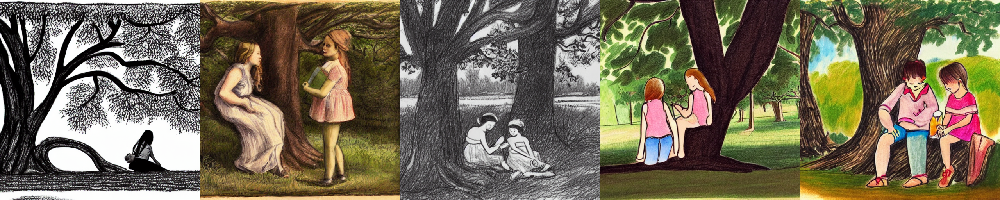

In [ ]:
image_grid(image_set[5], rows=1, cols=5)

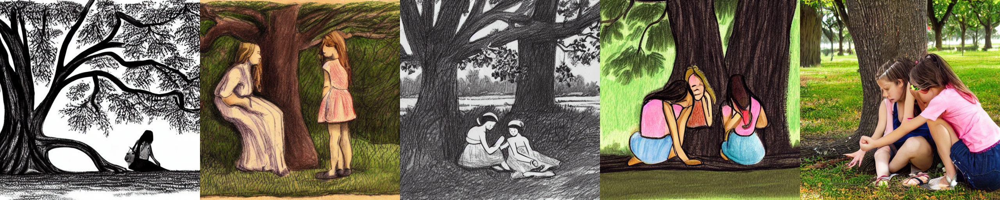

In [ ]:
image_grid(image_set[6], rows=1, cols=5)

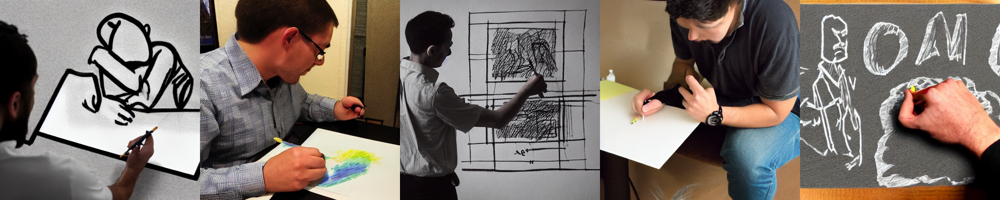

In [ ]:
image_grid(image_set[7], rows=1, cols=5)

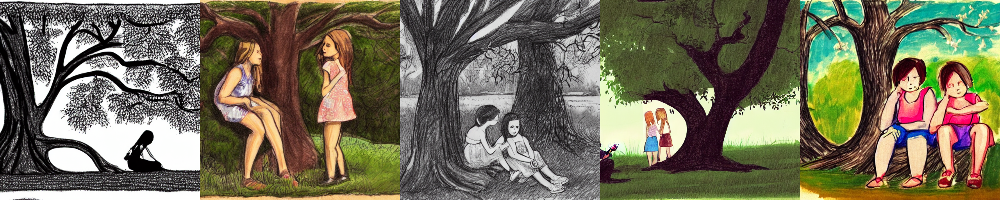

In [ ]:
image_grid(image_set[8], rows=1, cols=5)

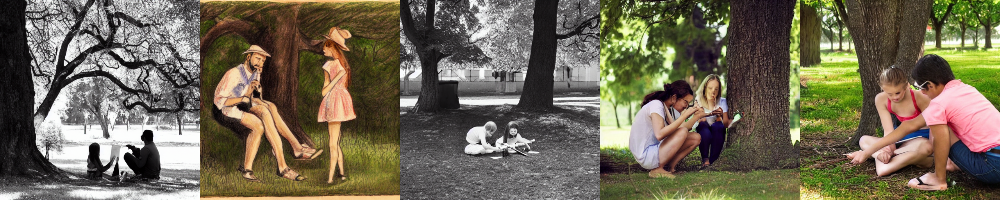

In [ ]:
image_grid(image_set[9], rows=1, cols=5)

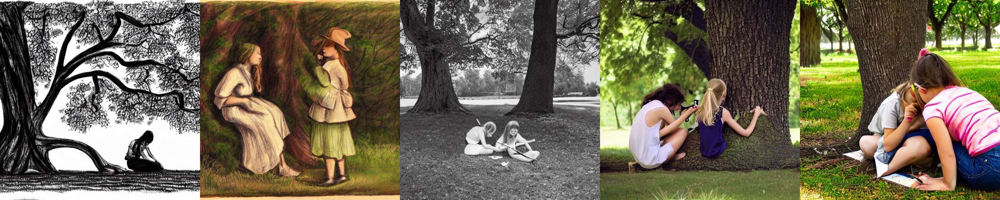

In [ ]:
image_grid(image_set[10], rows=1, cols=5)

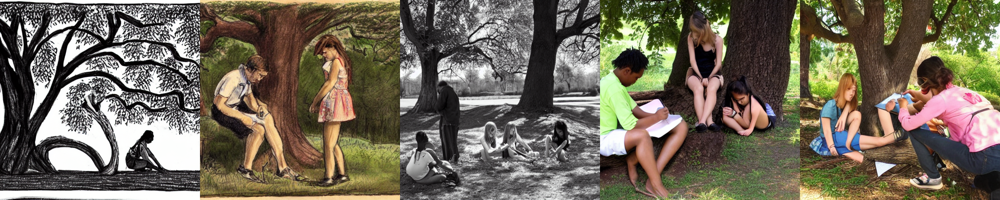

In [ ]:
image_grid(image_set[11], rows=1, cols=5)

In [ ]:
import pandas as pd

image_names = ['image12', 'image13', 'image14', 'image15', 'image16', 'image17', 'image18', 'image19', 'image110','image111','image112', 'image113', 'image114', 'image115', 'image116', 'image117', 'image118', 'image119', 'image120','image121','image122', 'image123', 'image124', 'image125', 'image126']
seed_names = ['pair1', 'pair2', 'pair3', 'pair4', 'pair5',]
df = pd.DataFrame(l2_norm, columns=seed_names, index=image_names)

In [ ]:
df

,pair1,pair2,pair3,pair4,pair5
image12,8431.069564,8838.095213,9020.986476,8714.628162,8942.721398
image13,8492.715585,8806.989100,8942.976742,8734.145751,8946.130560
image14,7741.364673,8938.786830,8613.849662,7758.933367,6658.034019
image15,8402.202152,9112.411207,8788.502375,8710.084443,7773.206224
image16,8551.464611,8823.815728,8948.006929,8721.799700,8831.407702
image17,8581.227476,8870.591581,8881.645062,8689.690904,7860.149808
image18,8999.352810,8893.380066,9129.564009,8903.665650,9119.910581
image19,8576.583994,8856.232721,8976.102049,8735.020836,8934.107734
image110,7306.211262,8815.902223,7989.104643,7430.348713,7393.615354
image111,8484.829992,8920.211993,8248.270788,8050.834801,8206.866454


In [ ]:
df["pair1"].sort_values(ascending = False)

image18     8999.352810
image115    8609.144905
image126    8604.201880
image124    8582.963999
image17     8581.227476
image19     8576.583994
image16     8551.464611
image112    8543.975831
image118    8539.873301
image113    8532.406108
image122    8531.903539
image125    8509.105770
image123    8506.427335
image13     8492.715585
image111    8484.829992
image121    8480.041804
image12     8431.069564
image116    8424.298309
image15     8402.202152
image114    8340.582893
image117    8303.834837
image120    8270.332944
image14     7741.364673
image119    7486.411824
image110    7306.211262
Name: pair1, dtype: float64

In [ ]:
df["pair2"].sort_values(ascending = False)

image15     9112.411207
image115    9050.478164
image112    9020.113303
image122    8946.762319
image121    8944.257040
image14     8938.786830
image120    8921.115345
image111    8920.211993
image117    8903.148488
image123    8898.642256
image125    8896.723442
image18     8893.380066
image124    8886.499311
image119    8884.225459
image17     8870.591581
image113    8859.655524
image19     8856.232721
image126    8845.129055
image12     8838.095213
image16     8823.815728
image118    8816.018432
image110    8815.902223
image13     8806.989100
image116    8768.706005
image114    8673.765734
Name: pair2, dtype: float64

In [ ]:
df["pair3"].sort_values(ascending = False)

image18     9129.564009
image121    9088.658592
image12     9020.986476
image122    9014.621013
image19     8976.102049
image124    8968.595932
image115    8964.194833
image16     8948.006929
image13     8942.976742
image125    8909.261193
image123    8908.184439
image17     8881.645062
image118    8870.881129
image15     8788.502375
image112    8708.282609
image114    8665.380315
image14     8613.849662
image116    8481.078056
image120    8313.459509
image111    8248.270788
image113    8174.361993
image126    8126.594674
image117    8059.243141
image119    8055.969215
image110    7989.104643
Name: pair3, dtype: float64

In [ ]:
df["pair4"].sort_values(ascending = False)

image114    9313.756009
image18     8903.665650
image115    8817.813278
image122    8771.826720
image118    8756.489708
image124    8755.113135
image120    8744.508505
image121    8741.748795
image19     8735.020836
image13     8734.145751
image125    8733.910865
image123    8729.398261
image16     8721.799700
image12     8714.628162
image15     8710.084443
image17     8689.690904
image112    8492.453768
image111    8050.834801
image117    7901.288756
image14     7758.933367
image119    7683.910658
image126    7550.142714
image110    7430.348713
image116    7337.524583
image113    7046.711219
Name: pair4, dtype: float64

In [ ]:
df["pair5"].sort_values(ascending = False)

image18     9119.910581
image115    8976.467568
image122    8946.662450
image13     8946.130560
image12     8942.721398
image19     8934.107734
image121    8932.754278
image125    8892.701277
image123    8890.868743
image124    8874.424826
image114    8852.408260
image16     8831.407702
image118    8439.117549
image120    8409.152989
image112    8374.924119
image126    8285.761100
image111    8206.866454
image113    7937.371227
image17     7860.149808
image15     7773.206224
image117    7737.823143
image116    7593.935409
image110    7393.615354
image14     6658.034019
image119    4773.040645
Name: pair5, dtype: float64

In [ ]:
import click
from PIL import Image, ImageFile
from transformers import CLIPProcessor, CLIPVisionModel
from collections import defaultdict
import torch.nn.functional as F
import random
import os

ImageFile.LOAD_TRUNCATED_IMAGES = True

"samples-11-30-7_5-flg1/0-en-dog-0.png"


# if image exists, open it. Else, generate 50x50 black
def open_image_if_exists(fname):
    if os.path.isfile(fname):
        return Image.open(fname, "r")
    else:
        return Image.new('RGB', (50, 50), (0, 0, 0))


def get_image_embeddings(processor, model, fnames):
    images = [open_image_if_exists(fname) for fname in fnames]
    inputs = processor(images=images, return_tensors="pt")
    inputs.to(model.device)
    outputs = model(**inputs)
    return outputs.pooler_output.squeeze()


def avg_cos_sim(vec_list_1, vec_list_2, is_self_sim=False):
    # this is O(n^2) lmao
    sims_sum = 0
    sims_num = vec_list_1.shape[0] * vec_list_2.shape[0] - is_self_sim * vec_list_1.shape[0]
    for i in range(vec_list_2.shape[0]):
        sims_sum += float(F.cosine_similarity(vec_list_1, vec_list_2[i].unsqueeze(0)).sum() - 1 * is_self_sim)
    return sims_sum / sims_num


# query cross-consistency
def compare_by_lang(results_dict, main_lang="en", similarity_func=avg_cos_sim):
    langs = results_dict.keys()
    # evaluate pairwise similarity
    output_dict = {}
    for lang in langs:
        output_dict[lang] = similarity_func(results_dict[main_lang], results_dict[lang], lang == main_lang)
    return output_dict


# query self-sim by lang
def lang_self_sim(results_dict, similarity_func=avg_cos_sim):
    langs = results_dict.keys()
    # evaluate pairwise similarity
    output_dict = {}
    for lang in langs:
        output_dict[lang] = similarity_func(results_dict[lang], results_dict[lang], True)
    return output_dict


# query self-sim by lang
def lang_cross_sim(results_dict_1, results_dict_2, similarity_func=avg_cos_sim):
    # suggest using larger vector as results_dict_1
    langs = results_dict_1.keys()
    # evaluate pairwise similarity
    output_dict = {}
    for lang in langs:
        output_dict[lang] = similarity_func(results_dict_1[lang], results_dict_2[lang], False)
    return output_dict


# results dict is a language-indexed dictionary of the gpu-placed word matrices
# the fingerprint dict is identical in structure but not tied to a word.

# produce a language-level index by precomputing the n=0 image for every word, language pair
def precompute_fingerprint_matrix(processor, model, prompts_base, analysis_dir, selection_count, number_spec_range=12):
    fingerprints = {}
    index = prompts_base[0].strip().split(",")
    if selection_count >= len(prompts_base) - 1 or selection_count == -1:
        use_lines = prompts_base[1:]
    else:
        use_lines = random.sample(range(len(prompts_base) - 1), selection_count)
    # extract a fingerprint for each language
    for idx in range(len(index)):
        fnames = []
        for line_no in use_lines:
            line = prompts_base[line_no + 1]
            line = line.strip().split(",")
            # sample a number in the correct range
            img_idx = random.randrange(number_spec_range)
            fnames.append(f"{analysis_dir}/{line_no}-{index[idx]}-{line[0]}-{img_idx}.png")
        fingerprints[index[idx]] = get_image_embeddings(processor, model, fnames)
    return fingerprints


@click.command()
@click.option('--analysis_dir', default='samples_sd2')
@click.option('--num_samples', default=12)
@click.option('--fingerprint_selection_count', default=100)
@click.option('--main_language', default="en")
def main(analysis_dir, num_samples, fingerprint_selection_count, main_language):
    device = "cuda"
    model = CLIPVisionModel.from_pretrained("openai/clip-vit-base-patch32")
    processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")
    model.to(device)

    prompts_base = open("frequencylist/freq_lists_translated.csv", "r").readlines()
    index = prompts_base[0].strip().split(",")

    out_lines_main_sim = [prompts_base[0]]
    out_lines_self_sim = [prompts_base[0]]
    out_lines_main_spec = [prompts_base[0]]

    # collect the fingerprints for each language in this model
    fingerprints = precompute_fingerprint_matrix(processor, model, prompts_base, analysis_dir,
                                                 fingerprint_selection_count)
    # language fingerprint self-similarity (negative diversity)
    inverse_diversity = lang_self_sim(fingerprints)
    print(f"INVERSE_DIVERSITY: {inverse_diversity}")
    with open(f"{analysis_dir}/language_diversity.csv", "w") as f:
        f.writelines([prompts_base[0], ",".join([str(inverse_diversity[index]) for index in index]) + "\n"])

    for line_no, line in enumerate(prompts_base[1:]):
        results_dict = defaultdict(list)
        line = line.strip().split(",")

        # collect this languages embeddings
        for idx in range(len(index)):
            # build a prompt based on the above templates from the
            fnames = [f"{analysis_dir}/{line_no}-{index[idx]}-{line[0]}-{i}.png" for i in range(num_samples)]
            image_embedding = get_image_embeddings(processor, model, fnames)
            results_dict[index[idx]] = image_embedding

        language_similarities = compare_by_lang(results_dict, main_lang=main_language)
        self_sims = lang_self_sim(results_dict)
        inverse_specificity = lang_cross_sim(fingerprints, results_dict)

        # zero out if there's an error log for each word
        for language in index:
            if os.path.isfile(f"{analysis_dir}/{line_no}-{language}-{line[0]}-failure.log"):
                language_similarities[language] = "---"
                self_sims[language] = "---"
                inverse_specificity[language] = "---"

        print(f"{main_language} SIM " + line[0] + " " + str(language_similarities))
        print("self SIM " + line[0] + " " + str(self_sims))
        print("specific " + line[0] + " " + str(inverse_specificity))

        out_lines_main_sim.append(",".join([str(language_similarities[language]) for language in index]) + "\n")
        out_lines_self_sim.append(",".join([str(self_sims[language]) for language in index]) + "\n")
        out_lines_main_spec.append(",".join([str(inverse_specificity[language]) for language in index]) + "\n")

    with open(f"{analysis_dir}/results_{main_language}.csv", "w") as f:
        f.writelines(out_lines_main_sim)

    with open(f"{analysis_dir}/results_self.csv", "w") as f:
        f.writelines(out_lines_self_sim)

    with open(f"{analysis_dir}/results_specific.csv", "w") as f:
        f.writelines(out_lines_main_spec)


if __name__ == "__main__":
    main()

ModuleNotFoundError: ignored